c:\Users\ASUS\.conda\envs\deeplearn\Lib\site-packages\skimage\feature\texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


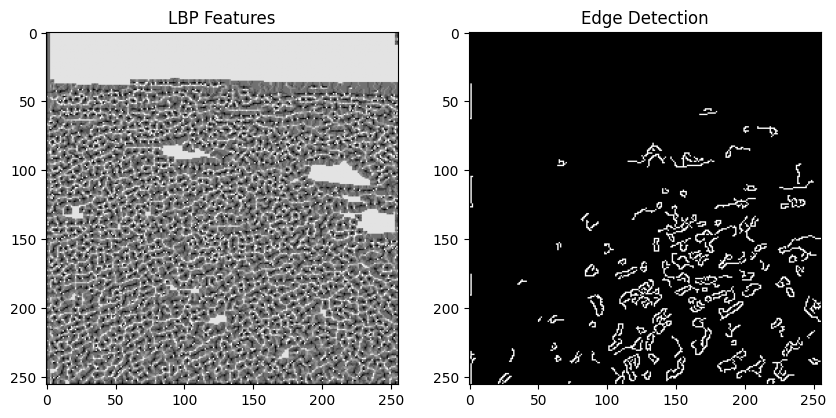

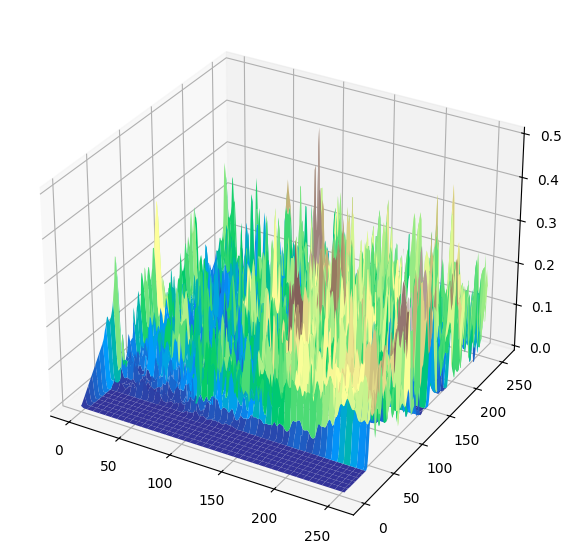

In [11]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from mpl_toolkits.mplot3d import Axes3D

# Step 1: Load and Preprocess Images
def load_and_preprocess(image_path):
    img = cv2.imread(image_path)
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img_resized = cv2.resize(img_gray, (256, 256))
    img_normalized = img_resized / 255.0
    img_denoised = cv2.GaussianBlur(img_normalized, (5, 5), 0)
    return img_denoised

# Step 2: Feature Extraction (LBP & Edge Detection)
def extract_features(img):
    lbp = local_binary_pattern(img, P=8, R=1, method="uniform")
    edges = cv2.Canny((img * 255).astype(np.uint8), 100, 200)
    return lbp, edges

# Step 3: Crater Detection using U-Net (Placeholder Model)
def build_unet():
    from tensorflow.keras.layers import Conv2D, MaxPooling2D, UpSampling2D, Input, concatenate
    from tensorflow.keras.models import Model
    
    inputs = Input((256, 256, 1))
    c1 = Conv2D(64, (3, 3), activation='relu', padding='same')(inputs)
    p1 = MaxPooling2D((2, 2))(c1)
    
    c2 = Conv2D(128, (3, 3), activation='relu', padding='same')(p1)
    p2 = MaxPooling2D((2, 2))(c2)
    
    u1 = UpSampling2D((2, 2))(p2)
    c3 = Conv2D(64, (3, 3), activation='relu', padding='same')(u1)
    
    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c3)
    model = Model(inputs, outputs)
    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

# Step 4: Terrain Classification using CNN (ResNet50 Transfer Learning)
def build_resnet_classifier():
    base_model = ResNet50(weights="imagenet", include_top=False, input_shape=(256, 256, 3))
    x = Flatten()(base_model.output)
    x = Dense(256, activation='relu')(x)
    output = Dense(3, activation='softmax')(x)  # 3 terrain classes
    model = Model(inputs=base_model.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Step 5: 3D Surface Visualization
def plot_3d_surface(img):
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')
    X, Y = np.meshgrid(range(img.shape[1]), range(img.shape[0]))
    ax.plot_surface(X, Y, img, cmap="terrain")
    plt.show()

image_path = r"datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0618343982_d_img_gnh_038.png"


img_processed = load_and_preprocess(image_path)
lbp_features, edge_map = extract_features(img_processed)

# Plot Results
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.title("LBP Features")
plt.imshow(lbp_features, cmap='gray')
plt.subplot(1,2,2)
plt.title("Edge Detection")
plt.imshow(edge_map, cmap='gray')
plt.show()

plot_3d_surface(img_processed)


In [12]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the lunar surface image
image_path = r"datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0859039663_d_img_nno_047.png"

image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)

# ------------------------------
# 1️⃣ Detect Terrain Edge
# ------------------------------
terrain_y = np.argmax(gray > 0, axis=0)  # First non-black pixel in each column
terrain_x = np.arange(gray.shape[1])  # X-coordinates

# Select key points along the edge
step = max(1, len(terrain_x) // 10)  # Reduce points for homography
terrain_points = np.column_stack((terrain_x[::step], terrain_y[::step])).astype(np.float32)

# ------------------------------
# 2️⃣ Define Reference Grid (Regular)
# ------------------------------
grid_size = 10  # Grid resolution
grid_width = 300
grid_height = 100  # Keep it shallow to match terrain

reference_grid = np.column_stack((
    np.linspace(0, grid_width, len(terrain_points)),  # Spread across X
    np.full_like(terrain_points[:, 1], grid_height)   # Keep Y fixed
)).astype(np.float32)

# ------------------------------
# 3️⃣ Compute Homography & Warp Grid
# ------------------------------
H, _ = cv2.findHomography(reference_grid, terrain_points)

# Draw the warped grid on the image
for i in range(grid_size + 1):
    # Vertical lines
    pt1 = np.dot(H, np.array([i * grid_width / grid_size, 0, 1]))
    pt2 = np.dot(H, np.array([i * grid_width / grid_size, grid_height, 1]))
    pt1 = (int(pt1[0] / pt1[2]), int(pt1[1] / pt1[2]))
    pt2 = (int(pt2[0] / pt2[2]), int(pt2[1] / pt2[2]))
    cv2.line(image, pt1, pt2, (255, 0, 0), 1)

    # Horizontal lines
    pt3 = np.dot(H, np.array([0, i * grid_height / grid_size, 1]))
    pt4 = np.dot(H, np.array([grid_width, i * grid_height / grid_size, 1]))
    pt3 = (int(pt3[0] / pt3[2]), int(pt3[1] / pt3[2]))
    pt4 = (int(pt4[0] / pt4[2]), int(pt4[1] / pt4[2]))
    cv2.line(image, pt3, pt4, (255, 0, 0), 1)

# Show the image with the terrain-aligned grid
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title("Projected Grid on Lunar Terrain")
plt.show()


TypeError: unsupported operand type(s) for *: 'NoneType' and 'float'

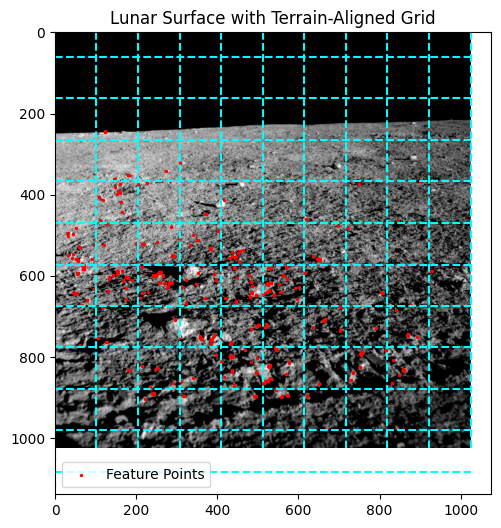

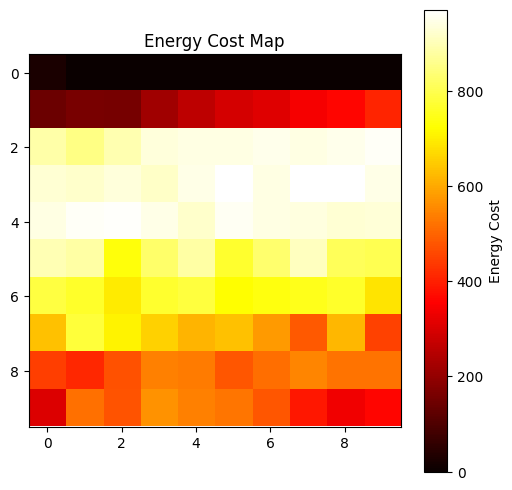

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the lunar surface image
image_path = r"datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0859039663_d_img_nno_047.png"

image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# ------------------------------
# 1️⃣ Detect Terrain Features
# ------------------------------

# Apply Canny edge detection (for surface features)
edges = cv2.Canny(image, 50, 150)

# Detect ORB keypoints (for feature-based alignment)
orb = cv2.ORB_create(500)  # Extract 500 keypoints
keypoints = orb.detect(image, None)

# Draw keypoints on image
image_keypoints = cv2.drawKeypoints(image, keypoints, None, color=(0, 255, 0))

# ------------------------------
# 2️⃣ Define Grid (Aligned to Terrain)
# ------------------------------

# Grid size (adjust based on resolution)
rows, cols = 10, 10  # Define grid divisions
h, w = image.shape

# Create a warped grid based on terrain
x_grid = np.linspace(0, w, cols+1, dtype=int)
y_grid = np.linspace(0, h, rows+1, dtype=int)

# Warping grid based on terrain roughness
for i in range(len(y_grid)):
    for j in range(len(x_grid)):
        y_grid[i] += int(10 * np.sin(x_grid[j] * np.pi / w))  # Simulated warping

# ------------------------------
# 3️⃣ Assign Energy Costs
# ------------------------------
energy_grid = np.zeros((rows, cols))

for i in range(rows):
    for j in range(cols):
        # Check if the cell contains edges (rough terrain)
        cell = edges[y_grid[i]:y_grid[i+1], x_grid[j]:x_grid[j+1]]
        edge_density = np.mean(cell)  # More edges = rougher terrain

        # Assign energy cost based on terrain roughness
        energy_grid[i, j] = edge_density * 10  # Scaled energy cost

# ------------------------------
# 4️⃣ Plot Everything
# ------------------------------

# Plot original image
plt.figure(figsize=(10, 6))
plt.imshow(image, cmap="gray")
plt.title("Lunar Surface with Terrain-Aligned Grid")

# Plot grid lines
for x in x_grid:
    plt.plot([x, x], [0, h], color="cyan", linestyle="--")
for y in y_grid:
    plt.plot([0, w], [y, y], color="cyan", linestyle="--")

plt.scatter([kp.pt[0] for kp in keypoints], [kp.pt[1] for kp in keypoints], c="red", s=2, label="Feature Points")
plt.legend()
plt.show()

# Show energy cost grid
plt.figure(figsize=(6, 6))
plt.imshow(energy_grid, cmap="hot", interpolation="nearest")
plt.colorbar(label="Energy Cost")
plt.title("Energy Cost Map")
plt.show()


Episode 100/100
Training Complete! 🚀


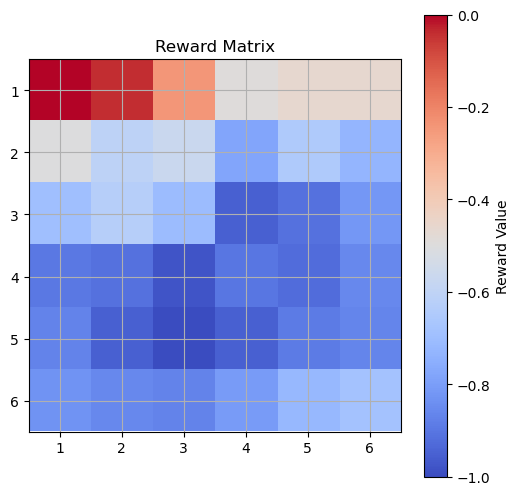

KeyboardInterrupt: 

In [1]:
import numpy as np
import random
import matplotlib.pyplot as plt

# 6x6 Energy Cost Matrix
energy_cost = np.array([
    [0.83120665, 0.85904648, 0.86740642, 0.80785085, 0.72221092, 0.6821429],
    [0.8677406, 0.95105498, 1., 0.95264647, 0.88683092, 0.86433875],
    [0.89544802, 0.91301993, 0.97772431, 0.89844197, 0.92461879, 0.85710395],
    [0.69357809, 0.63251866, 0.70333501, 0.95006792, 0.91024824, 0.81895411],
    [0.50223527, 0.60647121, 0.56991673, 0.77890135, 0.65087462, 0.72998675],
    [0., 0.04277713, 0.24311663, 0.49470234, 0.46368594, 0.46379897]
])
energy_cost = np.flip(energy_cost, 0)
# Convert energy cost to reward (lower energy = higher reward)
reward_matrix = -energy_cost.copy()

# Define actions (Up, Down, Left, Right)
actions = {
    0: (-1, 0),  # Up
    1: (1, 0),   # Down
    2: (0, -1),  # Left
    3: (0, 1)    # Right
}

# Q-table initialization (6x6 grid, 4 actions)
q_table = np.zeros((6, 6, 4))

# Hyperparameters
alpha = 0.1   # Learning rate
gamma = 0.9   # Discount factor
epsilon = 1.0 # Exploration rate
decay = 0.99  # Decay rate for exploration
episodes = 100

# Start and Goal states
start_state = (0, 0)  # (1,1) in grid
goal_state = (5, 5)   # (6,6) in grid

# Q-learning Algorithm
for episode in range(episodes):
    state = start_state
    done = False
    if (episode + 1) % 100 == 0:
        print(f"Episode {episode + 1}/{episodes}")

    while not done:
        # Choose action using ε-greedy policy
        if random.uniform(0, 1) < epsilon:
            action = random.choice(list(actions.keys()))  # Explore
        else:
            action = np.argmax(q_table[state[0], state[1]])  # Exploit
        
        # Get next state
        new_x = max(0, min(5, state[0] + actions[action][0]))
        new_y = max(0, min(5, state[1] + actions[action][1]))
        next_state = (new_x, new_y)
        
        # Get reward
        reward = reward_matrix[next_state]

        # Update Q-table using Bellman equation
        q_table[state[0], state[1], action] = (1 - alpha) * q_table[state[0], state[1], action] + \
            alpha * (reward + gamma * np.max(q_table[next_state[0], next_state[1]]))

        # Move to next state
        state = next_state

        # Check if goal is reached
        if state == goal_state:
            done = True

    # Decay epsilon
    epsilon *= decay

print("Training Complete! 🚀")

# -------------------------
# **Step 2: Generate Reward Map**
# -------------------------
plt.figure(figsize=(6,6))
plt.imshow(reward_matrix, cmap='coolwarm', interpolation='nearest')
plt.colorbar(label="Reward Value")
plt.title("Reward Matrix")
plt.xticks(np.arange(6), labels=[1,2,3,4,5,6])
plt.yticks(np.arange(6), labels=[1,2,3,4,5,6])
plt.grid()
plt.show()

# -------------------------
# **Step 3: Compute Optimal Path**
# -------------------------
path = [start_state]
state = start_state
while state != goal_state:
    action = np.argmax(q_table[state[0], state[1]])
    new_x = max(0, min(5, state[0] + actions[action][0]))
    new_y = max(0, min(5, state[1] + actions[action][1]))
    state = (new_x, new_y)
    path.append(state)

# Visualize optimal path
path_matrix = np.zeros((6,6))
for (x,y) in path:
    path_matrix[x,y] = 1  # Mark path cells

plt.figure(figsize=(6,6))
plt.imshow(path_matrix, cmap='Blues', interpolation='nearest')
plt.colorbar(label="Path Intensity")
plt.title("Optimal Path from (1,1) to (6,6)")
plt.xticks(np.arange(6), labels=[1,2,3,4,5,6])
plt.yticks(np.arange(6), labels=[1,2,3,4,5,6])
plt.grid()
plt.show()


Reference Grid Points:
 [[  0.   0.]
 [500.   0.]
 [500. 500.]
 [  0. 500.]]
Terrain Points:
 [[ 390.  270.]
 [1650.  270.]
 [1950. 1020.]
 [ 150. 1020.]]
Homography Matrix:
 [[ 2.52000000e+00 -5.70000000e-01  3.90000000e+02]
 [ 6.59103314e-18  8.88000000e-01  2.70000000e+02]
 [ 1.02186560e-20 -6.00000000e-04  1.00000000e+00]]


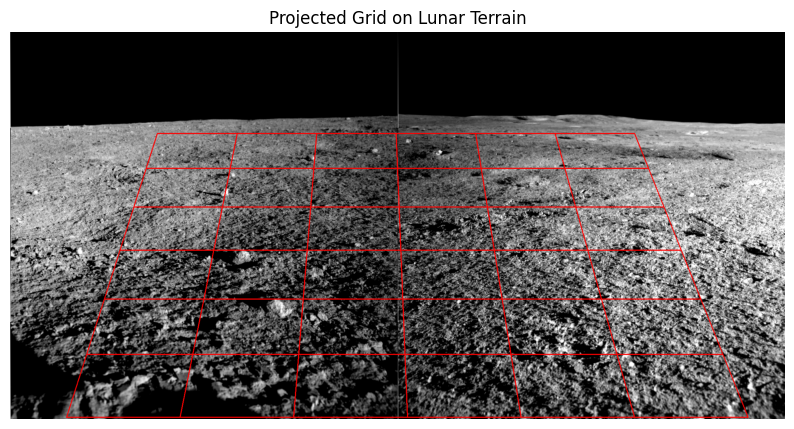

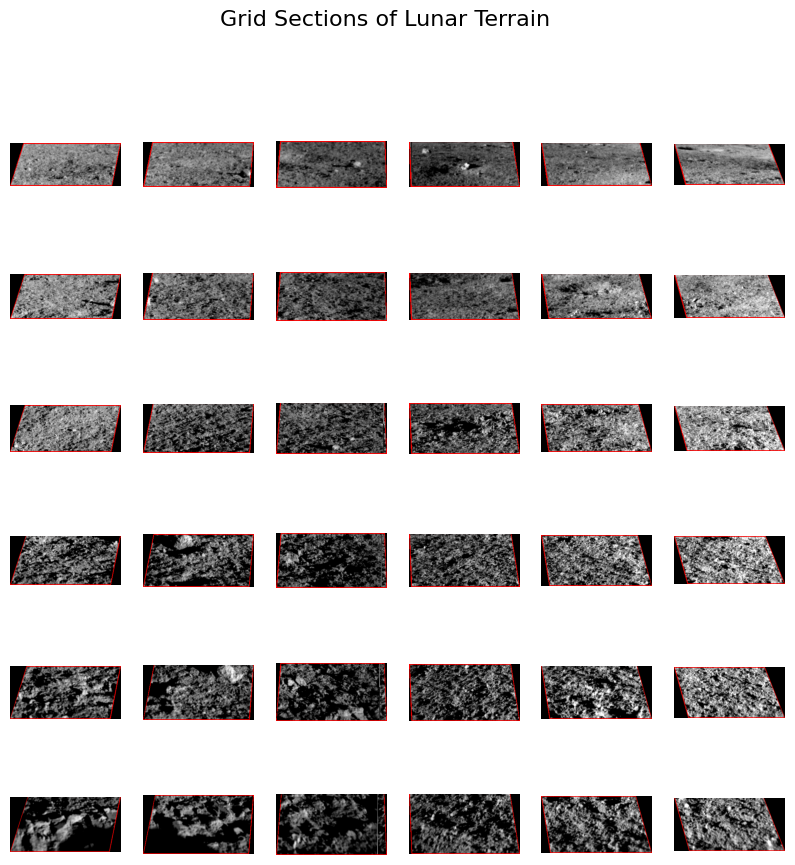

In [7]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the lunar surface image
image_path = r"D:\research_implementation\lunar_surface\merged_image.png"

image = cv2.imread(image_path)
if image is None:
    raise ValueError("Image not found. Check the path.")

image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ------------------------------
# 1️⃣ Define Manually Selected Terrain Points
# ------------------------------
terrain_points = np.array([
    [390, 270],  # Top-left
    [1650, 270],
      [1950, 1020]   ,
    [150, 1020],  # Bottom-right
], dtype=np.float32)

# ------------------------------
# 2️⃣ Define a Regular Grid for Mapping
# ------------------------------
grid_width = 500
grid_height = 500

reference_grid = np.array([
    [0, 0],               # Top-left
    [grid_width, 0],      # Top-right
    [grid_width, grid_height],  # Bottom-right
    [0, grid_height]      # Bottom-left
], dtype=np.float32)

# Debug: Print Point Correspondences
print("Reference Grid Points:\n", reference_grid)
print("Terrain Points:\n", terrain_points)

# ------------------------------
# 3️⃣ Compute Homography
# ------------------------------
H, status = cv2.findHomography(reference_grid, terrain_points)

if H is None:
    raise ValueError("Homography computation failed. Ensure points correspond correctly.")

print("Homography Matrix:\n", H)

# ------------------------------
# 4️⃣ Draw Grid on Image
# ------------------------------
grid_size = 6  # Grid resolution
for i in range(grid_size + 1):
    try:
        # Vertical lines
        pt1 = np.dot(H, np.array([i * grid_width / grid_size, 0, 1]))
        pt2 = np.dot(H, np.array([i * grid_width / grid_size, grid_height, 1]))
        pt1 = (int(pt1[0] / pt1[2]), int(pt1[1] / pt1[2]))
        pt2 = (int(pt2[0] / pt2[2]), int(pt2[1] / pt2[2]))
        cv2.line(image, pt1, pt2, (255, 0, 0), 2)

        # Horizontal lines
        pt3 = np.dot(H, np.array([0, i * grid_height / grid_size, 1]))
        pt4 = np.dot(H, np.array([grid_width, i * grid_height / grid_size, 1]))
        pt3 = (int(pt3[0] / pt3[2]), int(pt3[1] / pt3[2]))
        pt4 = (int(pt4[0] / pt4[2]), int(pt4[1] / pt4[2]))
        cv2.line(image, pt3, pt4, (255, 0, 0), 2)
    except:
        print(f"Skipping line {i} due to invalid transformation.")

# Show the image with the grid
plt.figure(figsize=(10, 6))
plt.imshow(image)
plt.axis("off")
plt.title("Projected Grid on Lunar Terrain")
plt.show()

# visualize the each grid section
# Visualize each grid section separately
fig, axs = plt.subplots(grid_size, grid_size, figsize=(10, 10))

for i in range(grid_size):
    for j in range(grid_size):
        # Define the corners of the grid cell
        pt1 = np.dot(H, np.array([j * grid_width / grid_size, i * grid_height / grid_size, 1]))
        pt2 = np.dot(H, np.array([(j + 1) * grid_width / grid_size, i * grid_height / grid_size, 1]))
        pt3 = np.dot(H, np.array([(j + 1) * grid_width / grid_size, (i + 1) * grid_height / grid_size, 1]))
        pt4 = np.dot(H, np.array([j * grid_width / grid_size, (i + 1) * grid_height / grid_size, 1]))

        # Normalize points
        pts = np.array([
            [int(pt1[0] / pt1[2]), int(pt1[1] / pt1[2])],
            [int(pt2[0] / pt2[2]), int(pt2[1] / pt2[2])],
            [int(pt3[0] / pt3[2]), int(pt3[1] / pt3[2])],
            [int(pt4[0] / pt4[2]), int(pt4[1] / pt4[2])]
        ], dtype=np.int32)

        # Create a mask for the grid cell
        mask = np.zeros_like(image[:, :, 0])
        cv2.fillPoly(mask, [pts], 255)

        # Extract the grid cell using the mask
        grid_section = cv2.bitwise_and(image, image, mask=mask)
        x, y, w, h = cv2.boundingRect(pts)
        grid_section = grid_section[y:y+h, x:x+w]

        # Display the grid section
        axs[i, j].imshow(grid_section)
        axs[i, j].axis("off")

plt.suptitle("Grid Sections of Lunar Terrain", fontsize=16)
plt.show()

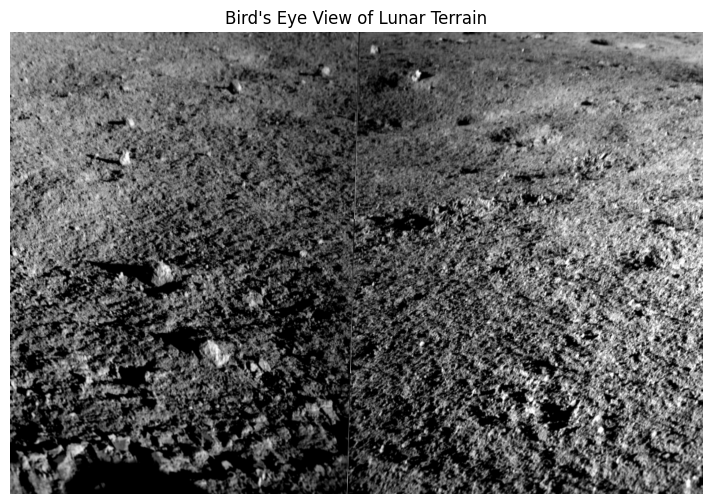

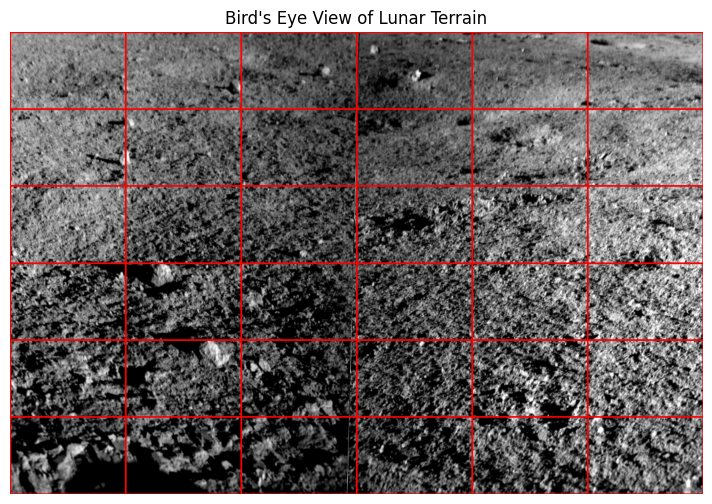

In [3]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the lunar surface image
image_path = r"D:\research_implementation\lunar_surface\merged_image.png"
image = cv2.imread(image_path)
if image is None:
    raise ValueError("Image not found. Check the path.")

image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# ------------------------------
# 1️⃣ Define Manually Selected Terrain Points
# ------------------------------
terrain_points = np.array([
    [390, 270],    # Top-left
    [1650, 270],   # Top-right
    [1950, 1020],  # Bottom-right
    [150, 1020]    # Bottom-left
], dtype=np.float32)

# ------------------------------
# 2️⃣ Reference Grid for Bird's Eye View
# ------------------------------
grid_width, grid_height = 1200, 800
reference_grid = np.array([
    [0, 0],
    [grid_width, 0],
    [grid_width, grid_height],
    [0, grid_height]
], dtype=np.float32)

# ------------------------------
# 3️⃣ Compute Homography
# ------------------------------
H, _ = cv2.findHomography(terrain_points, reference_grid)

# ------------------------------
# 4️⃣ Apply Perspective Warp for Bird's Eye View
# ------------------------------
bird_eye_view = cv2.warpPerspective(image, H, (grid_width, grid_height))
plt.imsave("bird_eye_view_lunarsurface_nogrid.png",bird_eye_view)
plt.figure(figsize=(10, 6))
plt.imshow(bird_eye_view)
plt.axis("off")
plt.title("Bird's Eye View of Lunar Terrain")
plt.show()
# ------------------------------
# 5️⃣ Draw Grid on Bird's Eye View
# ------------------------------
grid_size = 6
for i in range(grid_size + 1):
    # Vertical lines
    cv2.line(bird_eye_view, (i * grid_width // grid_size, 0),
             (i * grid_width // grid_size, grid_height), (255, 0, 0), 2)

    # Horizontal lines
    cv2.line(bird_eye_view, (0, i * grid_height // grid_size),
             (grid_width, i * grid_height // grid_size), (255, 0, 0), 2)

# ------------------------------
# 6️⃣ Display Result
# ------------------------------
plt.figure(figsize=(10, 6))
plt.imshow(bird_eye_view)
plt.axis("off")
plt.title("Bird's Eye View of Lunar Terrain")
plt.show()


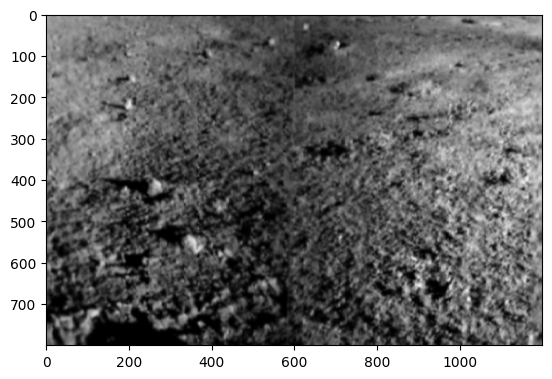

In [7]:
import cv2
import numpy as np

# Load the merged image
image = cv2.imread("bird_eye_view_lunarsurface_nogrid.png")

# Convert to grayscale for edge detection
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edges = cv2.Canny(gray, 30, 100)

# Find contours of the seam
contours, _ = cv2.findContours(edges, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
for cnt in contours:
    x, y, w, h = cv2.boundingRect(cnt)
    if w < 10:  # Narrow seam threshold
        image[:, x:x+w] = cv2.GaussianBlur(image[:, x:x+w], (3, 3), 0)

# Save and display the result
# cv2.imwrite("seam_removed.jpg", image)
plt.imshow(image)


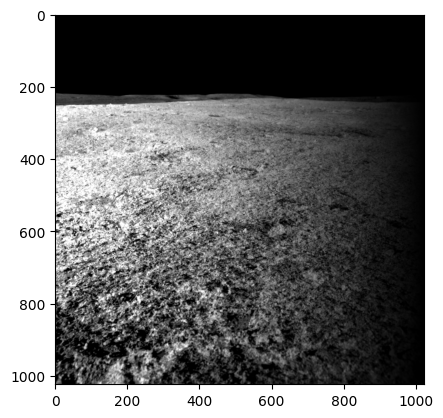

In [2]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
# Load images 
# Load two images
image1_path = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0858238377_d_img_nno_047.png"
image2_path = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0203387831_d_img_gnh_037.png"

img1 = cv2.imread(image1_path)
img2 = cv2.imread(image2_path)

# Ensure both images are the same height
height = min(img1.shape[0], img2.shape[0])
img1 = img1[:height, :]
img2 = img2[:height, :]

# Create a gradient mask for blending
width = img1.shape[1] + img2.shape[1]
mask = np.zeros((height, width, 3), dtype=np.float32)
for i in range(img1.shape[1]):
    mask[:, i] = (i / img1.shape[1])  # Left fades in
for i in range(img2.shape[1]):
    mask[:, img1.shape[1] + i] = 1 - (i / img2.shape[1])  # Right fades out

# Convert to float for blending
img1 = img1.astype(np.float32)
img2 = img2.astype(np.float32)

# Merge images using mask
blended = (img1 * (1 - mask[:, :img1.shape[1]])) + (img2 * mask[:, img1.shape[1]:])

# Convert back to uint8
blended = np.clip(blended, 0, 255).astype(np.uint8)

# cv2.imwrite("gradient_blended.jpg", blended)
plt.imshow(blended)



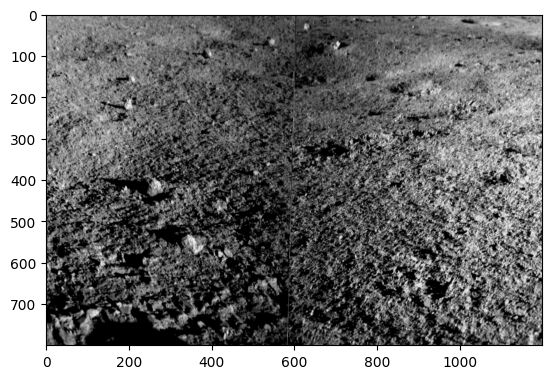

In [3]:
# Load image
image = cv2.imread("bird_eye_view_lunarsurface_nogrid.png")

# Convert to grayscale to detect the seam
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
_, mask = cv2.threshold(gray, 245, 255, cv2.THRESH_BINARY)  # Detect the bright seam

# Use inpainting to remove the seam
fixed = cv2.inpaint(image, mask, inpaintRadius=3, flags=cv2.INPAINT_TELEA)

plt.imshow(fixed)


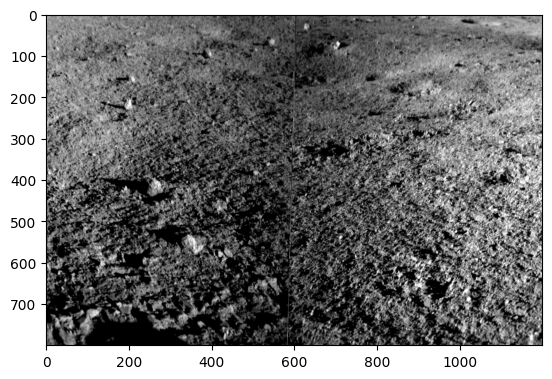

In [5]:
import cv2
import numpy as np

# Use the already defined image variable
image = image.astype(np.float32)

# Min-Max Normalization
min_val, max_val = np.min(image), np.max(image)
normalized = ((image - min_val) / (max_val - min_val)) * 255
normalized = np.clip(normalized, 0, 255).astype(np.uint8)

plt.imshow(normalized)


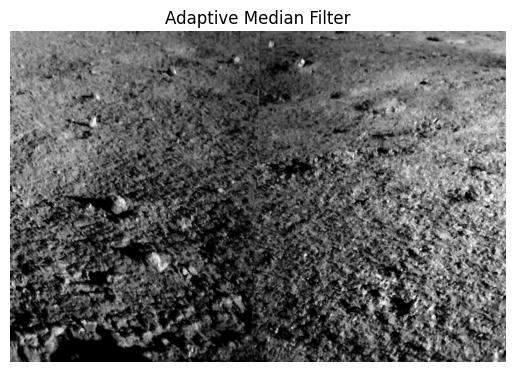

In [9]:
import cv2
import numpy as np

# Load image
image = cv2.imread("bird_eye_view_lunarsurface_nogrid.png", cv2.IMREAD_GRAYSCALE)

# Define an adaptive median filter
def adaptive_median_filter(img, max_window_size=7):
    padded_img = np.pad(img, max_window_size // 2, mode='edge')
    filtered_img = np.zeros_like(img)

    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            window_size = 3
            while window_size <= max_window_size:
                kernel = padded_img[i:i + window_size, j:j + window_size]
                med = np.median(kernel)
                min_val, max_val = np.min(kernel), np.max(kernel)

                if min_val < med < max_val:
                    if min_val < img[i, j] < max_val:
                        filtered_img[i, j] = img[i, j]
                    else:
                        filtered_img[i, j] = med
                    break
                else:
                    window_size += 2
                if window_size > max_window_size:
                    filtered_img[i, j] = med

    return filtered_img

# Apply filter
filtered = adaptive_median_filter(image.astype(np.uint8))

cv2.imwrite("adaptive_median_filtered.jpg", filtered)
plt.imshow(filtered, cmap='gray')
plt.title("Adaptive Median Filter")
plt.axis("off")
plt.show()


In [12]:
import cv2
import numpy as np

# Load image
image = cv2.imread("merged_image.png", cv2.IMREAD_GRAYSCALE)

# Apply Sobel filter (Gradient detection)
sobelx = cv2.Sobel(image, cv2.CV_64F, 1, 0, ksize=5)
sobely = cv2.Sobel(image, cv2.CV_64F, 0, 1, ksize=5)
sobel = cv2.magnitude(sobelx, sobely)  # Compute gradient magnitude

# Normalize to 0-255 for visualization
lidar_view = cv2.normalize(sobel, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

cv2.imwrite("lidar_view.jpg", lidar_view)
cv2.imshow("LiDAR View", lidar_view)


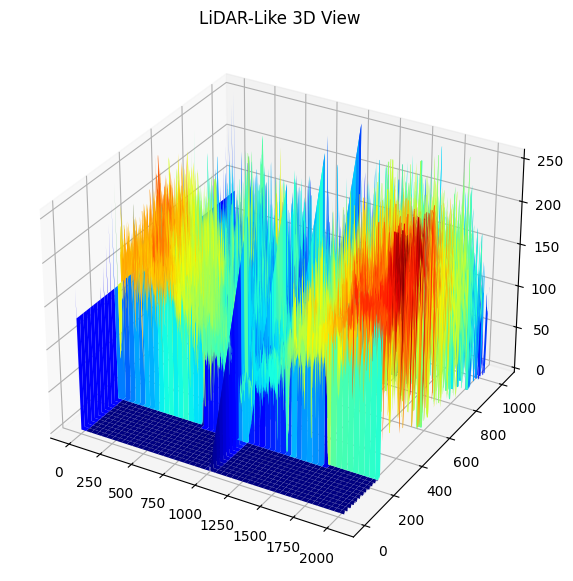

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load grayscale image
# image = cv2.imread("surface_image.jpg", cv2.IMREAD_GRAYSCALE)

# Generate X, Y grid
h, w = image.shape
x, y = np.meshgrid(np.arange(w), np.arange(h))

# Use pixel intensity as height (Z-axis)
z = image.astype(np.float32)

# Plot the 3D surface
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(x, y, z, cmap='jet')

plt.title("LiDAR-Like 3D View")
plt.show()


In [ ]:
# Load image
import cv2
import numpy as np
image = cv2.imread("merged_image.png", cv2.IMREAD_GRAYSCALE)

# Apply Laplacian filter for depth simulation
depth_map = cv2.Laplacian(image, cv2.CV_64F)

# Normalize for better visualization
depth_map = cv2.normalize(depth_map, None, 0, 255, cv2.NORM_MINMAX).astype(np.uint8)

cv2.imwrite("depth_map.jpg", depth_map)
cv2.imshow("LiDAR Depth Map", depth_map)



: 

In [ ]:
import numpy as np
import random

# ------------------------------
# 1️⃣ Define Environment
# ------------------------------
grid_size = 5  # 5x5 grid
actions = ["up", "down", "left", "right"]
Q_table = np.zeros((grid_size, grid_size, len(actions)))  # Q-values initialized to 0

# Reward Map (Manually Assigned or Extracted from Image)
reward_map = np.array([
    [  5,  5,  5, -10, -50],  
    [  5, -1, -1, -10, -50],
    [  5, -1, 10, -10, -50],
    [  5, -1, -1, -10, -50],
    [  5,  5,  5,   5,  100]  # Goal state
])

# Energy Cost Map (Higher values for rough terrain)
energy_map = np.array([
    [1, 1, 2, 5, 10],
    [1, 2, 2, 5, 10],
    [1, 2, 1, 5, 10],
    [1, 2, 2, 5, 10],
    [1, 1, 1, 1, 0]  # Goal state
])

# Hyperparameters
alpha = 0.1  # Learning rate
gamma = 0.9  # Discount factor
epsilon = 0.1  # Exploration rate

# ------------------------------
# 2️⃣ Q-Learning Algorithm
# ------------------------------
num_episodes = 1000

for episode in range(num_episodes):
    state = (0, 0)  # Start position
    done = False

    while not done:
        x, y = state

        # Choose action (epsilon-greedy)
        if random.uniform(0, 1) < epsilon:
            action_index = np.random.choice(len(actions))
        else:
            action_index = np.argmax(Q_table[x, y])

        # Take action
        if actions[action_index] == "up" and x > 0:
            next_state = (x - 1, y)
        elif actions[action_index] == "down" and x < grid_size - 1:
            next_state = (x + 1, y)
        elif actions[action_index] == "left" and y > 0:
            next_state = (x, y - 1)
        elif actions[action_index] == "right" and y < grid_size - 1:
            next_state = (x, y + 1)
        else:
            next_state = state  # Invalid move

        # Get reward & energy penalty
        reward = reward_map[next_state]
        energy_penalty = energy_map[next_state]

        # Update Q-table
        Q_table[x, y, action_index] = Q_table[x, y, action_index] + alpha * (
            reward - energy_penalty + gamma * np.max(Q_table[next_state]) - Q_table[x, y, action_index]
        )

        # Move to next state
        state = next_state

        # Terminal condition (Goal reached)
        if state == (4, 4):
            done = True

# ------------------------------
# 3️⃣ Visualize Results
# ------------------------------
print("Final Q-Table:")
print(Q_table)

print("\nReward Map:")
print(reward_map)

print("\nEnergy Map:")
print(energy_map)


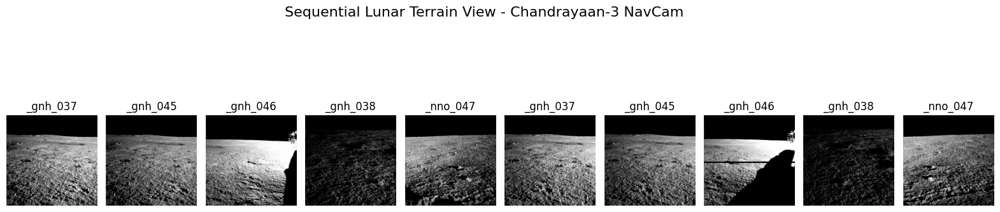

Sorted Image Paths:
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0202579496_d_img_gnh_037.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0202579496_d_img_gnh_045.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0602577575_d_img_gnh_046.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0617542696_d_img_gnh_038.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0858238377_d_img_nno_047.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0203387831_d_img_gnh_037.png
D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\

In [6]:
import os
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Filepath to your NavCam dataset
filepath = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420"

# List to store image paths and filenames
image_paths = []
filenames = []

# Traverse through all files in the directory
for root, dirs, files in os.walk(filepath):
    for file in files:
        if file.endswith(".png"):
            image_path = os.path.join(root, file)
            image_paths.append(image_path)
            filenames.append(file)

# Sort filenames and image paths based on datetime (since filenames contain timestamp)
sorted_indices = np.argsort(filenames)
sorted_image_paths = [image_paths[idx] for idx in sorted_indices]
sorted_filenames = [filenames[idx] for idx in sorted_indices]

# Plot the images in a single row for a panoramic/elongated view
fig, axs = plt.subplots(1, len(sorted_image_paths), figsize=(20, 5))

for i, img_path in enumerate(sorted_image_paths):
    # Read and convert image
    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    # Plot the image in a horizontal row
    axs[i].imshow(img_rgb)
    axs[i].axis("off")
    axs[i].set_title(sorted_filenames[i][-12:-4])  # Show only timestamp from the filename

# Adjust spacing and layout
plt.subplots_adjust(wspace=0.1, hspace=0)
plt.suptitle("Sequential Lunar Terrain View - Chandrayaan-3 NavCam", fontsize=16)
plt.show()

# Print the sorted file paths
print("Sorted Image Paths:")
for path in sorted_image_paths:
    print(path)


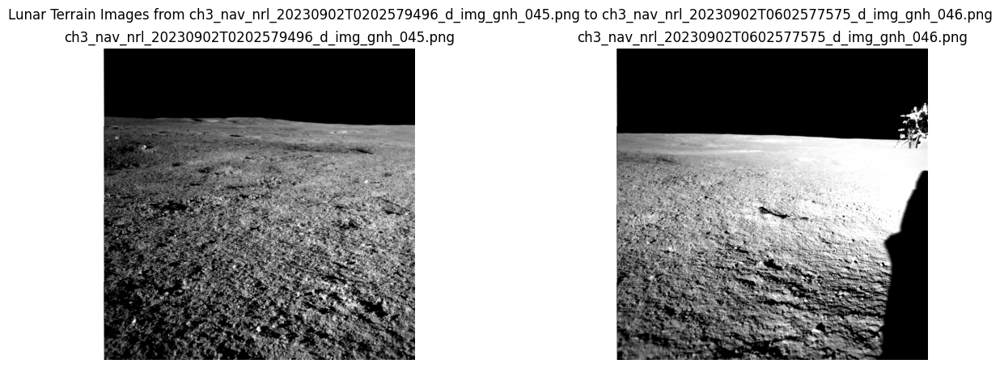

In [13]:
# -------------------------------
# Continuation Code to View Images in Range
# -------------------------------

# Define the range of images to display
start_idx = 1   # Change this to your desired start index
end_idx = 3     # Change this to your desired end index

# Plot the images in the specified range
plt.figure(figsize=(15, 5))
for i in range(start_idx, end_idx):
    img = cv2.imread(sorted_image_paths[i])
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    plt.subplot(1, end_idx-start_idx, i-start_idx+1)
    plt.imshow(img_rgb)
    plt.title(sorted_filenames[i])
    plt.axis("off")

plt.suptitle(f"Lunar Terrain Images from {sorted_filenames[start_idx]} to {sorted_filenames[end_idx-1]}")
plt.show()


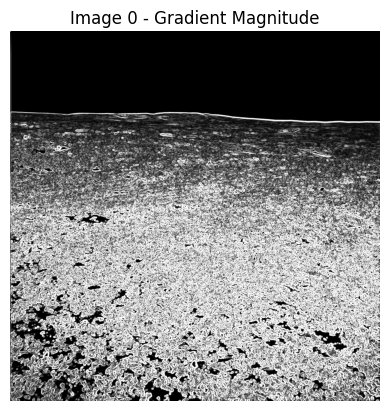

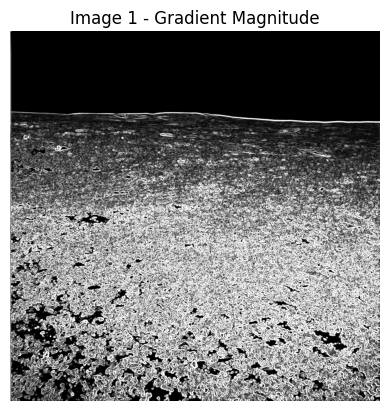

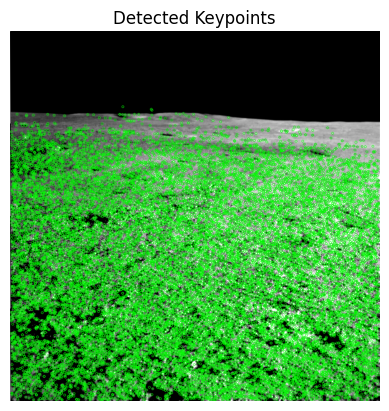

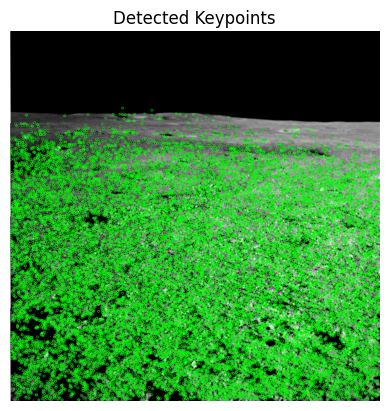

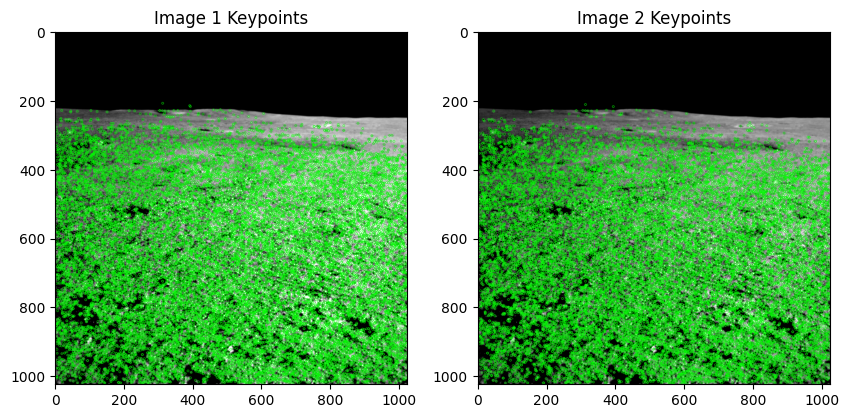

...

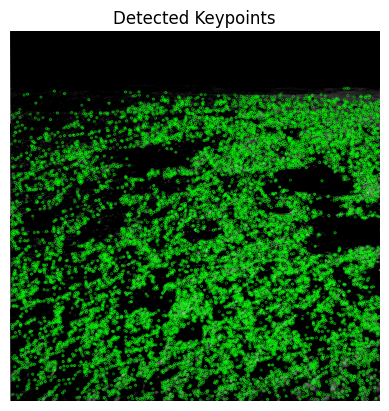

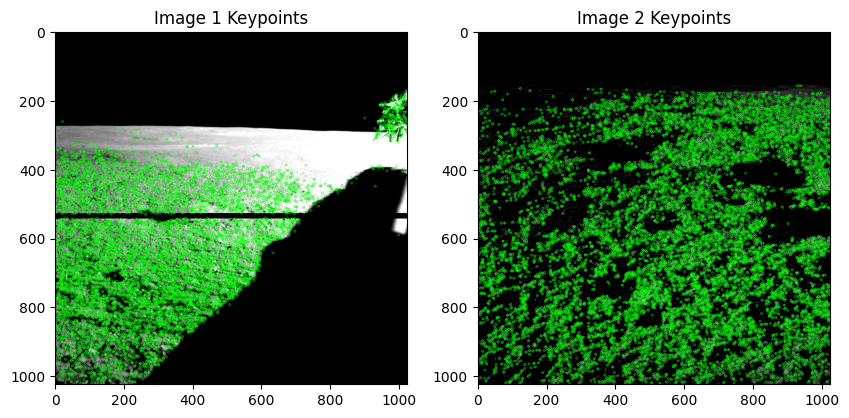

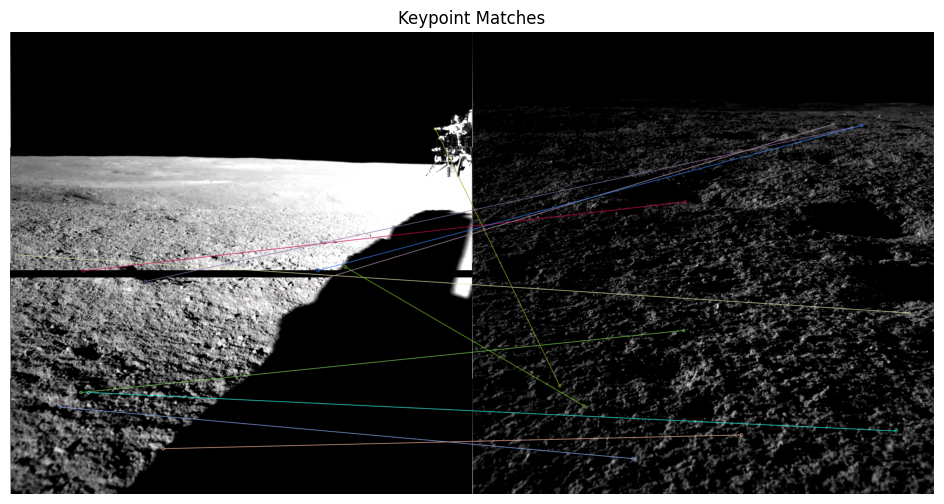

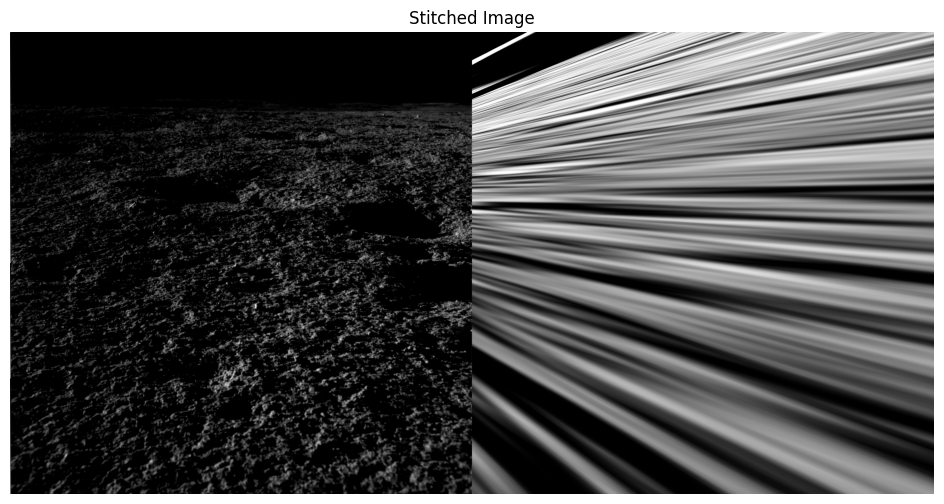

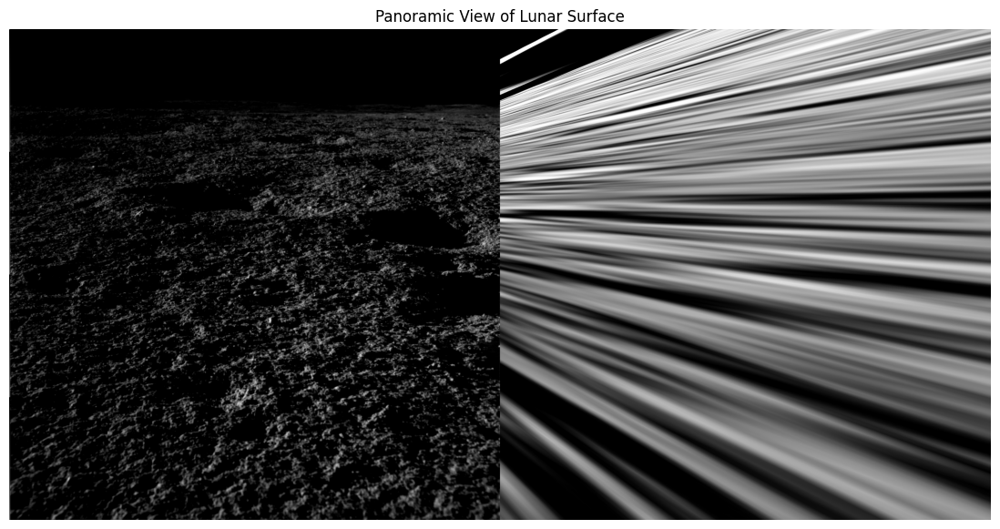

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Directory of your images
filepath = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420"

# Load and sort images by timestamp from filenames
image_paths = []
for root, dirs, files in os.walk(filepath):
    for file in sorted(files):
        if file.endswith(".png"):
            image_paths.append(os.path.join(root, file))

# Function to show image gradient (for surface features)
def visualize_gradients(image, title):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Compute Gradients (Sobel X and Y)
    grad_x = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=3)
    grad_y = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=3)
    
    # Combine gradients
    magnitude = np.sqrt(grad_x**2 + grad_y**2)
    magnitude = cv2.convertScaleAbs(magnitude)
    
    # Plot Gradient Magnitude
    plt.figure()
    plt.imshow(magnitude, cmap='gray')
    plt.title(f'{title} - Gradient Magnitude')
    plt.axis('off')
    plt.show()

# Function to detect keypoints and descriptors
def detect_keypoints(image):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    sift = cv2.SIFT_create()
    keypoints, descriptors = sift.detectAndCompute(gray, None)
    
    # Plot keypoints
    img_keypoints = cv2.drawKeypoints(image, keypoints, None, color=(0, 255, 0))
    plt.figure()
    plt.imshow(cv2.cvtColor(img_keypoints, cv2.COLOR_BGR2RGB))
    plt.title("Detected Keypoints")
    plt.axis('off')
    plt.show()
    
    return keypoints, descriptors

# Function to stitch images
def stitch_images(img1, img2):
    # Convert to grayscale
    gray1 = cv2.cvtColor(img1, cv2.COLOR_BGR2GRAY)
    gray2 = cv2.cvtColor(img2, cv2.COLOR_BGR2GRAY)
    
    # SIFT feature detector
    sift = cv2.SIFT_create()
    keypoints1, descriptors1 = sift.detectAndCompute(gray1, None)
    keypoints2, descriptors2 = sift.detectAndCompute(gray2, None)
    
    # Visualize keypoints
    img1_keypoints = cv2.drawKeypoints(img1, keypoints1, None, color=(0,255,0))
    img2_keypoints = cv2.drawKeypoints(img2, keypoints2, None, color=(0,255,0))
    
    plt.figure(figsize=(10,5))
    plt.subplot(1,2,1)
    plt.imshow(cv2.cvtColor(img1_keypoints, cv2.COLOR_BGR2RGB))
    plt.title("Image 1 Keypoints")
    
    plt.subplot(1,2,2)
    plt.imshow(cv2.cvtColor(img2_keypoints, cv2.COLOR_BGR2RGB))
    plt.title("Image 2 Keypoints")
    plt.show()
    
    # FLANN Based Matcher (fast feature matching)
    index_params = dict(algorithm=1, trees=5)
    search_params = dict(checks=50)
    flann = cv2.FlannBasedMatcher(index_params, search_params)
    
    # Match keypoints
    matches = flann.knnMatch(descriptors1, descriptors2, k=2)
    
    # Apply Lowe's ratio test
    good_matches = []
    for m, n in matches:
        if m.distance < 0.7 * n.distance:
            good_matches.append(m)
    
    # Draw matches
    matched_img = cv2.drawMatches(img1, keypoints1, img2, keypoints2, good_matches, None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    plt.figure(figsize=(12,6))
    plt.imshow(matched_img)
    plt.title("Keypoint Matches")
    plt.axis('off')
    plt.show()
    
    # Extract location of good matches
    src_pts = np.float32([keypoints1[m.queryIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    dst_pts = np.float32([keypoints2[m.trainIdx].pt for m in good_matches]).reshape(-1, 1, 2)
    
    # RANSAC Homography
    H, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)
    
    # Warp image 1 to image 2
    height, width, channels = img2.shape
    result = cv2.warpPerspective(img1, H, (width*2, height))
    result[0:height, 0:width] = img2
    
    # Show Stitched Image
    plt.figure(figsize=(12,6))
    plt.imshow(cv2.cvtColor(result, cv2.COLOR_BGR2RGB))
    plt.title("Stitched Image")
    plt.axis('off')
    plt.show()

    return result

# ----------------------------
# PROCESSING IMAGES
# ----------------------------
stitched_image = None

for i in range(1, len(image_paths)-1):
    # Load images
    img1 = cv2.imread(image_paths[i-1])
    img2 = cv2.imread(image_paths[i])
    
    # Convert to RGB
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)
    
    # Visualize Image Gradients
    visualize_gradients(img1, f"Image {i-1}")
    visualize_gradients(img2, f"Image {i}")
    
    # Detect Keypoints and Descriptors
    detect_keypoints(img1)
    detect_keypoints(img2)
    
    # Perform Image Stitching
    stitched_image = stitch_images(img1, img2)
    img1 = stitched_image

# Show Final Panorama
plt.figure(figsize=(15,7))
plt.imshow(stitched_image)
plt.title("Panoramic View of Lunar Surface")
plt.axis('off')
plt.show()


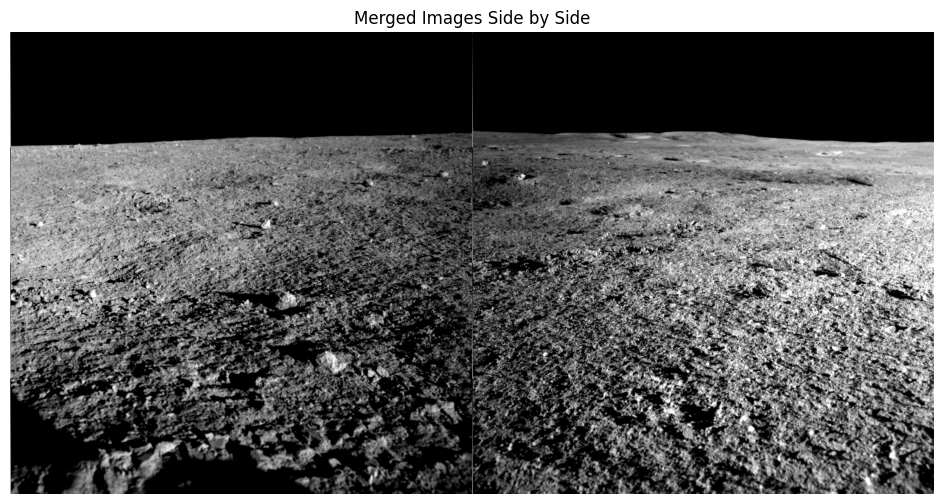

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load two images
image1_path = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrl_20230902T0858238377_d_img_nno_047.png"
image2_path = r"D:\research_implementation\lunar_surface\datasets\navcam_2024Oct29T115459420\nav\data\raw\20230902\ch3_nav_nrr_20230902T0203387831_d_img_gnh_037.png"

img1 = cv2.imread(image1_path)
img2 = cv2.imread(image2_path)

# Convert to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Resize both images to have the same height
height = min(img1.shape[0], img2.shape[0])
img1 = cv2.resize(img1, (int(img1.shape[1] * (height/img1.shape[0])), height))
img2 = cv2.resize(img2, (int(img2.shape[1] * (height/img2.shape[0])), height))

# Concatenate the two images horizontally
merged_image = np.hstack((img1, img2))

# Display the merged image
plt.figure(figsize=(12,6))
plt.imshow(merged_image)
plt.title("Merged Images Side by Side")
plt.axis('off')
plt.show()


In [29]:
plt.imsave("merged_image.png", merged_image)

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import random
import cv2

# Load the lunar surface image
image_path = "D:\\research_implementation\\lunar_surface\\merged_image.png"
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Define grid size
grid_size = 6

# Define energy cost as the negative reward (so the agent minimizes cost)
energy_cost = np.array([
    [0.8312, 0.8590, 0.8674, 0.8078, 0.7222, 0.6821],
    [0.8677, 0.9510, 1.0000, 0.9526, 0.8868, 0.8643],
    [0.8954, 0.9130, 0.9777, 0.8984, 0.9246, 0.8571],
    [0.6935, 0.6325, 0.7033, 0.9500, 0.9102, 0.8189],
    [0.5022, 0.6064, 0.5699, 0.7789, 0.6508, 0.7299],
    [0.0000, 0.0427, 0.2431, 0.4947, 0.4636, 0.4637]
])

# Convert to negative rewards (minimizing cost)
reward_matrix = -energy_cost.copy()

# Set goal reward
reward_matrix[-1, -1] = 100  # High reward for goal state

# Define actions (up, down, left, right)
actions = [(0, 1), (0, -1), (1, 0), (-1, 0)]

def get_valid_actions(state):
    i, j = state
    valid_moves = []
    for action in actions:
        ni, nj = i + action[0], j + action[1]
        if 0 <= ni < grid_size and 0 <= nj < grid_size:
            valid_moves.append((ni, nj))
    return valid_moves

# Initialize Q-table
Q = np.zeros((grid_size, grid_size, len(actions)))

# Q-learning parameters
alpha = 0.1  # Learning rate
gamma = 0.9  # Discount factor
epsilon = 0.1  # Exploration-exploitation tradeoff

def q_learning(episodes=1000):
    for episode in range(episodes):
        state = (0, 0)  # Start at (1,1)
        while state != (grid_size - 1, grid_size - 1):  # Until goal reached
            # Choose action (ε-greedy)
            if random.uniform(0, 1) < epsilon:
                action_idx = random.choice(range(len(actions)))
            else:
                action_idx = np.argmax(Q[state[0], state[1]])
            
            # Take action
            new_state = (state[0] + actions[action_idx][0], state[1] + actions[action_idx][1])
            
            # Get reward
            reward = reward_matrix[new_state[0], new_state[1]]
            
            # Update Q-value
            Q[state[0], state[1], action_idx] = (1 - alpha) * Q[state[0], state[1], action_idx] + \
                alpha * (reward + gamma * np.max(Q[new_state[0], new_state[1]]))
            
            state = new_state

q_learning(episodes=5000)

# Extract Q-value max for each state
Q_values = np.max(Q, axis=2)

# Save Q-table
q_table_df = pd.DataFrame(Q_values)
q_table_df.to_csv("q_table.csv", index=False)

# Overlay path on lunar surface
optimal_path = [(0, 0)]
state = (0, 0)
while state != (grid_size - 1, grid_size - 1):
    action_idx = np.argmax(Q[state[0], state[1]])
    new_x = state[0] + actions[action_idx][0]
    new_y = state[1] + actions[action_idx][1]
    state = (new_x, new_y)
    optimal_path.append(state)

# Overlay path on image
overlay = image.copy()
cell_w, cell_h = image.shape[1] // grid_size, image.shape[0] // grid_size
for (x, y) in optimal_path:
    cv2.rectangle(overlay, (y * cell_w, x * cell_h), ((y + 1) * cell_w, (x + 1) * cell_h), (0, 255, 0), 2)

# Visualize overlay
plt.figure(figsize=(8, 6))
plt.imshow(overlay)
plt.title("Optimal Path Overlay on Lunar Surface")
plt.axis("off")
plt.show()

# Visualize Q-table
plt.figure(figsize=(8, 6))
plt.imshow(Q_values, cmap='viridis', interpolation='nearest')
plt.colorbar(label='Q-value')
plt.title("Q-learning Value Map")
plt.show()
